In [ ]:
!pip install pytesseract
!pip install easyocr

In [ ]:
import easyocr
# EasyOCR reader'ı başlat
reader = easyocr.Reader(['en'])

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("sujaymann/car-number-plate-dataset-yolo-format")

print("Path to dataset files:", path)

100%|██████████| 203M/203M [00:10<00:00, 21.0MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3


In [ ]:
import os

os.getcwd()

'/content'

In [ ]:
os.listdir('/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/')

['versions', '3.complete']

In [ ]:
os.listdir('/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/')

['3']

In [ ]:
os.listdir('/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3')

['License-Plate-Data']

In [ ]:
os.listdir('/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data')

['data.yaml', 'test', 'train']

In [ ]:
actual_path = '/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data'

In [ ]:
!pip install ultralytics -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 914.6/914.6 kB 41.7 MB/s eta 0:00:00


In [ ]:
import warnings

warnings.simplefilter('ignore')

import numpy as np
import cv2
import os
from ultralytics import YOLO
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
from matplotlib.patches import Rectangle
import pandas as pd

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
yaml_path = actual_path + "/data.yaml"
train_path = actual_path + "/train"
test_path = actual_path + "/test"

print(yaml_path)
print(train_path)
print(test_path)
print(os.listdir(train_path + "/labels/"))

/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/data.yaml
/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/train
/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test
['Cars100.txt', 'Cars141.txt', 'Cars407.txt', 'Cars68.txt', 'Cars351.txt', 'Cars369.txt', 'Cars133.txt', 'Cars126.txt', 'Cars426.txt', 'Cars129.txt', 'Cars364.txt', 'Cars331.txt', 'Cars285.txt', 'Cars111.txt', 'Cars327.txt', 'Cars0.txt', 'Cars53.txt', 'Cars373.txt', 'Cars428.txt', 'Cars244.txt', 'Cars410.txt', 'Cars389.txt', 'Cars412.txt', 'Cars427.txt', 'Cars182.txt', 'Cars155.txt', 'Cars46.txt', 'Cars235.txt', 'Cars51.txt', 'Cars80.txt', 'Cars24.txt', 'Cars211.txt', 'Cars186.txt', 'Cars132.txt', 'Cars232.txt', 'Cars324.txt', 'Cars283.txt', 'Cars64.txt', 'Cars382.txt', 'Cars247.txt', 'Cars31.txt', 'Cars243.txt', 'Cars197.txt', 'Cars124.txt', '

In [ ]:
def read_file(file_path, file_name):
    data = []
    with open(file_path, 'r') as f:
        annotations = f.readlines()

    for annotation in annotations:
        parts = annotation.strip().split()
        if len(parts) == 5:  # YOLO formatında doğru satır sayısı (5)
            class_id, x_center, y_center, width, height = map(float, parts)
            data.append([file_name] + [class_id, x_center, y_center, width, height])

    return data

In [ ]:
def create_data_frame(train_path):
    label_path = os.path.join(train_path, "labels")

    label_file_names = os.listdir(label_path)

    all_data = []

    for label_file in label_file_names:
        file_path = os.path.join(label_path, label_file)
        file_data = read_file(file_path, label_file)

        all_data.extend(file_data)

    columns = ['file_id', 'class_id', 'x_center', 'y_center', 'width', 'height']
    df = pd.DataFrame(all_data, columns=columns)

    return df


In [ ]:
df = create_data_frame(train_path)
df.head()

,file_id,class_id,x_center,y_center,width,height
0,Cars100.txt,0.0,0.48625,0.458801,0.0975,0.063670
1,Cars141.txt,0.0,0.71625,0.668539,0.1025,0.071161
2,Cars407.txt,0.0,0.82125,0.720974,0.0875,0.071161
3,Cars68.txt,0.0,0.54250,0.583955,0.1400,0.108209
4,Cars351.txt,0.0,0.77125,0.393333,0.2975,0.360000


In [ ]:
boxes = {}
images = {}
number_of_images = 5

print(os.listdir('/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/train/images/'))

if not df.empty:
    first_rows = df.iloc[0:number_of_images]
    for i in range(0, number_of_images):

      row = first_rows.iloc[i]  # Satırı al
      image_path = os.path.join(train_path, "images", row['file_id'].replace('.txt', '.png'))

      if os.path.exists(image_path):
          images[i] = cv2.imread(image_path)
          image_height, image_width = images[i].shape[:2]

          x_center = row['x_center'] * image_width
          y_center = row['y_center'] * image_height
          box_width = row['width'] * image_width
          box_height = row['height'] * image_height

          xmin = int(x_center - box_width / 2)
          xmax = int(x_center + box_width / 2)
          ymin = int(y_center - box_height / 2)
          ymax = int(y_center + box_height / 2)

          boxes[i] = [xmin, xmax, ymin, ymax]
      else:
          print(f"Resim bulunamadı: {image_path}")


['Cars220.png', 'Cars69.png', 'Cars427.png', 'Cars325.png', 'Cars225.png', 'Cars424.png', 'Cars267.png', 'Cars128.png', 'Cars107.png', 'Cars58.png', 'Cars98.png', 'Cars216.png', 'Cars175.png', 'Cars54.png', 'Cars105.png', 'Cars331.png', 'Cars60.png', 'Cars233.png', 'Cars136.png', 'Cars414.png', 'Cars428.png', 'Cars189.png', 'Cars413.png', 'Cars410.png', 'Cars288.png', 'Cars294.png', 'Cars426.png', 'Cars321.png', 'Cars378.png', 'Cars369.png', 'Cars79.png', 'Cars100.png', 'Cars19.png', 'Cars152.png', 'Cars239.png', 'Cars191.png', 'Cars411.png', 'Cars312.png', 'Cars285.png', 'Cars193.png', 'Cars114.png', 'Cars141.png', 'Cars148.png', 'Cars252.png', 'Cars342.png', 'Cars403.png', 'Cars131.png', 'Cars95.png', 'Cars112.png', 'Cars50.png', 'Cars106.png', 'Cars279.png', 'Cars137.png', 'Cars173.png', 'Cars398.png', 'Cars197.png', 'Cars358.png', 'Cars338.png', 'Cars226.png', 'Cars234.png', 'Cars372.png', 'Cars385.png', 'Cars67.png', 'Cars223.png', 'Cars171.png', 'Cars356.png', 'Cars300.png', 'Car

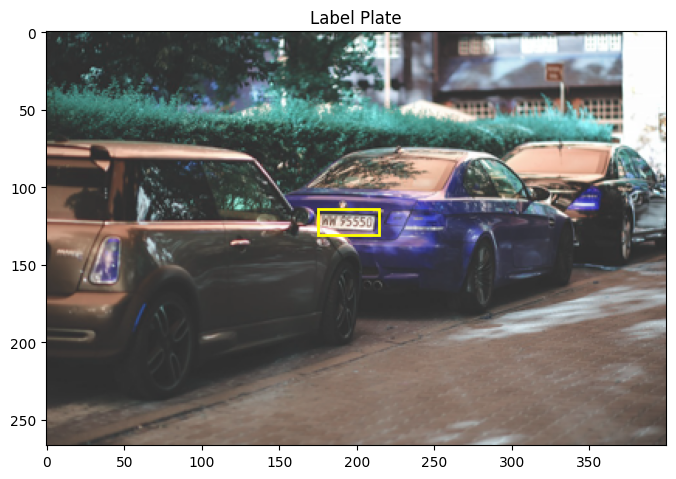

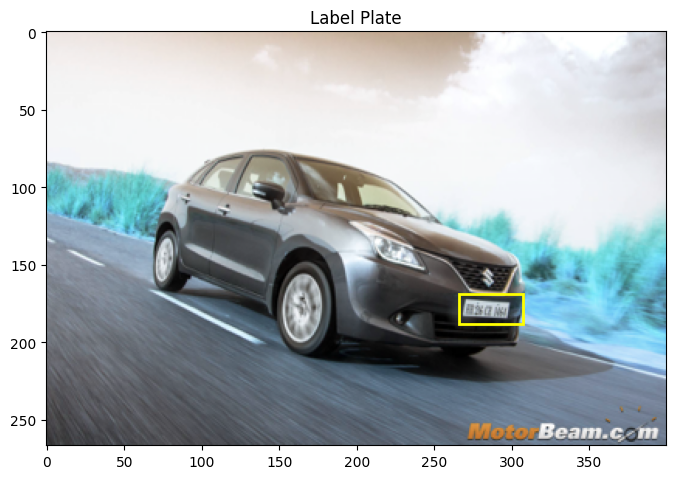

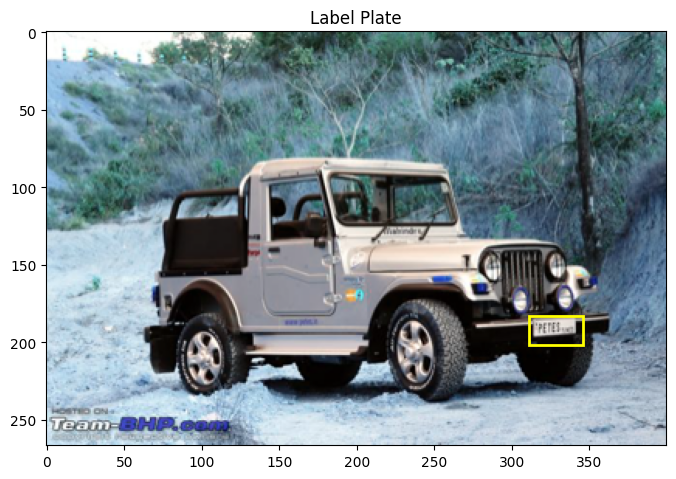

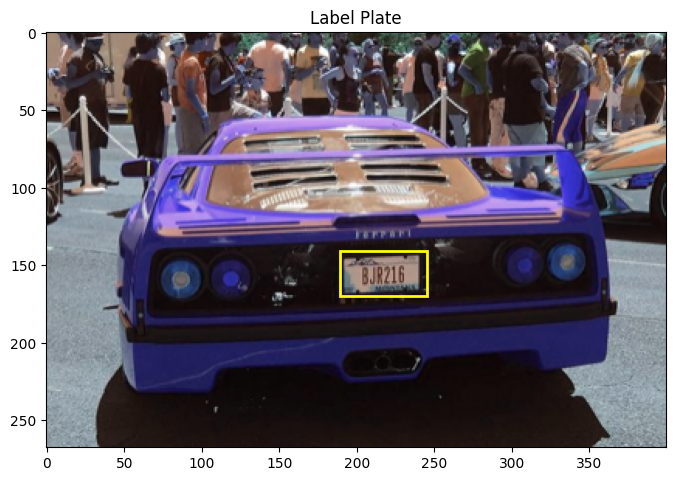

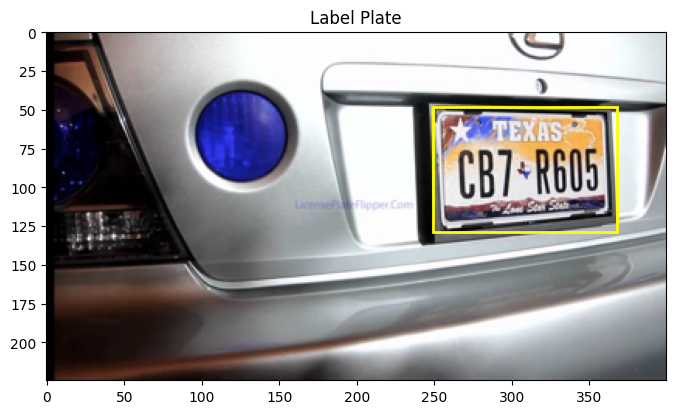

In [ ]:
for i in range(0, number_of_images):
  xmin, xmax, ymin, ymax = boxes[i][0], boxes[i][1], boxes[i][2], boxes[i][3]
  plt.figure(figsize=(8, 8))
  plt.title("Label Plate")
  plt.imshow(images[i])
  plt.gca().add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color='yellow', fill=False, linewidth=2))
  plt.show()

In [ ]:
model = YOLO('yolo11n.pt')

100%|██████████| 5.35M/5.35M [00:00<00:00, 129MB/s]


In [ ]:
import yaml
def yaml_creator():
    yaml_file_path = yaml_path

    data_dict = {
        'train': train_path,
        'val': test_path,
        'nc': 1,  # Sınıf sayısı
        'names': ['license_plate']  # Sınıf ismi
    }

    if os.path.exists(yaml_file_path):
        os.remove(yaml_file_path)
        print("Önceki dosya silindi!")

    with open(yaml_file_path, 'w') as yaml_file:
        yaml.dump(data_dict, yaml_file)

    print(f"YAML dosyası {yaml_file_path} oluşturuldu.")


In [ ]:

def yaml_reader():
    yaml_file_path = yaml_path

    if os.path.exists(yaml_file_path):
        with open(yaml_file_path, 'r') as yaml_file:
            file_content = yaml_file.read()

            data = yaml.safe_load(file_content)

            print("YAML dosyası içeriği:")
            print(data)

            return data
    else:
        print(f"{yaml_file_path} dosyası bulunamadı.")
        return None


In [ ]:
yaml_creator()
yaml_reader()

Önceki dosya silindi!
YAML dosyası /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/data.yaml oluşturuldu.
YAML dosyası içeriği:
{'names': ['license_plate'], 'nc': 1, 'train': '/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/train', 'val': '/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test'}


{'names': ['license_plate'],
 'nc': 1,
 'train': '/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/train',
 'val': '/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test'}

# Predictions before training

In [ ]:
results = model.val(data=yaml_path)

Ultralytics 8.3.69 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 238 layers, 2,616,248 parameters, 0 gradients, 6.5 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 54.8MB/s]
val: Scanning /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/labels... 87 images, 0 backgrounds, 0 corrupt: 100%|██████████| 87/87 [00:00<00:00, 193.28it/s]

val: New cache created: /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:08<00:00,  1.43s/it]

                   all         87         87          0          0          0          0


Speed: 4.1ms preprocess, 24.9ms inference, 0.0ms loss, 17.2ms postprocess per image
Results saved to runs/detect/val


In [ ]:
print(results.results_dict)


{'metrics/precision(B)': 0.0, 'metrics/recall(B)': 0.0, 'metrics/mAP50(B)': 0.0, 'metrics/mAP50-95(B)': 0.0, 'fitness': 0.0}


In [ ]:
# Predict on a new image
results = model.predict(test_path + '/images/*.png', imgsz=640)


image 1/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars109.png: 448x640 (no detections), 70.4ms
image 2/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars110.png: 448x640 1 car, 1 truck, 11.0ms
image 3/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars119.png: 416x640 3 persons, 7 cars, 1 motorcycle, 66.5ms
image 4/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars12.png: 256x640 1 car, 75.5ms
image 5/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars120.png: 448x640 1 car, 12.9ms
image 6/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars75.png: 416x640 4 persons, 21 cars, 5 buss, 2 trucks, 9.3ms
Speed: 1.8ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)


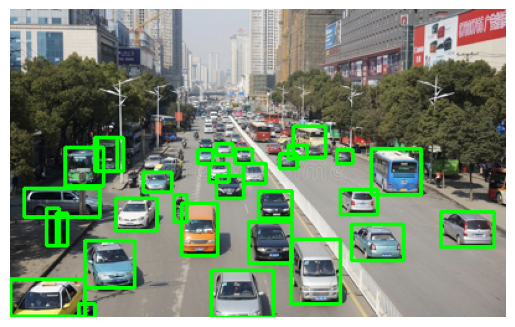


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars401.png: 480x640 1 car, 14.3ms
Speed: 3.4ms preprocess, 14.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


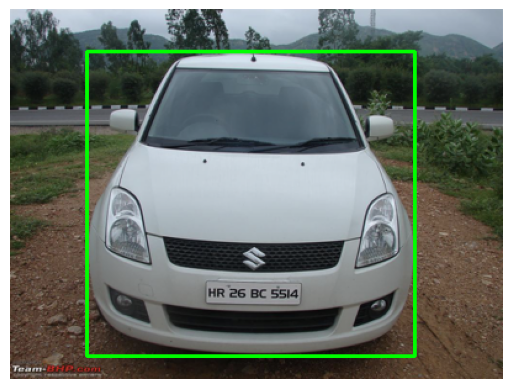


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars242.png: 640x640 4 cars, 12.4ms
Speed: 5.6ms preprocess, 12.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


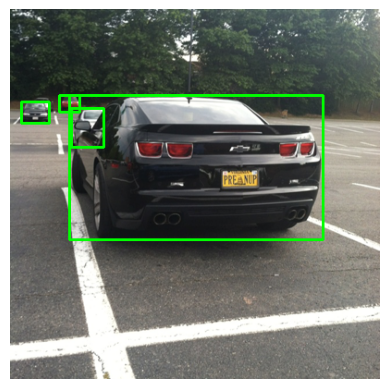


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars320.png: 640x480 1 car, 16.5ms
Speed: 3.6ms preprocess, 16.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)


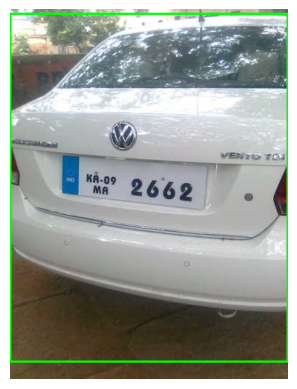


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars42.png: 384x640 1 car, 1 truck, 15.5ms
Speed: 2.8ms preprocess, 15.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


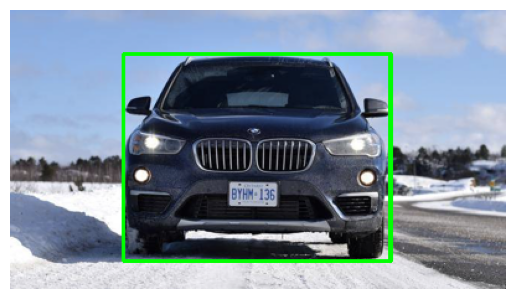

In [ ]:
import glob
image_folder = test_path + '/images'

image_files = glob.glob(os.path.join(image_folder, '*.png'))  # Tüm .png dosyalarını al

for image_path in image_files[0:number_of_images]:
    image = cv2.imread(image_path)

    results = model.predict(image_path)

    predictions = results[0].boxes  # İlk resmin kutuları

    for box in predictions:
        xmin, ymin, xmax, ymax = box.xyxy[0].cpu().numpy()
        confidence = box.conf[0].cpu().numpy()
        class_id = int(box.cls[0].cpu().numpy())

        cv2.rectangle(image, (int(xmin), int(ymin)), (int(xmax), int(ymax)), (0, 255, 0), 2)  # Yeşil kutu

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

In [ ]:

results = model.train(
    data=yaml_path,         # Eğitim verisinin yolu
    epochs=50,              # Daha uzun eğitim için epoch sayısını artırıyoruz
    imgsz=640,              # Görüntü boyutu (genellikle standarttır, 640 iyi bir denge)
    batch=32,          # Uygun bir batch size, sistem kaynaklarına bağlı olarak artırılabilir
    lr0=0.0001,               # Orta seviye bir öğrenme oranı, deneyle optimize edilebilir
    optimizer='Adam',       # Adam optimizasyon algoritması yaygın olarak kullanılır
    weight_decay=0.0005,    # Küçük bir weight decay değeri overfitting’i önler
    augment=True,           # Veri artırmayı etkinleştir
    patience=5,             # Early stopping için patience, modelin gelişmediği 5 epoch'tan sonra durdurur
    save_period=5,          # Her 5 epoch'ta bir model kaydedilir
)



Ultralytics 8.3.69 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/data.yaml, epochs=50, time=None, patience=5, batch=32, imgsz=640, save=True, save_period=5, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=Adam, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_t

train: Scanning /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/train/labels... 346 images, 0 backgrounds, 0 corrupt: 100%|██████████| 346/346 [00:00<00:00, 685.29it/s]


train: New cache created: /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/labels.cache... 87 images, 0 backgrounds, 0 corrupt: 100%|██████████| 87/87 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: Adam(lr=0.0001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      5.17G      3.248      4.803      2.721         62        640: 100%|██████████| 11/11 [00:08<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]

                   all         87         87   0.000345      0.103   0.000533   0.000232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      4.74G      2.067       3.27      1.737         49        640: 100%|██████████| 11/11 [00:09<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all         87         87   0.000518      0.046   0.000279   4.84e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      4.74G       1.72      2.179      1.525         54        640: 100%|██████████| 11/11 [00:05<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.76it/s]

                   all         87         87    0.00156      0.414     0.0264    0.00434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      4.74G       1.59      1.723      1.399         48        640: 100%|██████████| 11/11 [00:08<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.78it/s]

                   all         87         87   0.000631      0.103   0.000459   0.000108



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      4.74G      1.539       1.53      1.352         45        640: 100%|██████████| 11/11 [00:05<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         87         87    0.00724      0.287     0.0403     0.0205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      4.75G       1.52      1.428      1.311         52        640: 100%|██████████| 11/11 [00:06<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.78it/s]

                   all         87         87     0.0123      0.448       0.27      0.105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      4.74G      1.419      1.319      1.272         45        640: 100%|██████████| 11/11 [00:05<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         87         87       0.02      0.609      0.441      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      4.75G      1.465      1.314      1.275         47        640: 100%|██████████| 11/11 [00:06<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.79it/s]

                   all         87         87      0.959       0.27      0.643      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      4.74G      1.429      1.274      1.243         48        640: 100%|██████████| 11/11 [00:05<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.23it/s]

                   all         87         87      0.909      0.461      0.748      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      4.75G      1.473      1.266      1.287         52        640: 100%|██████████| 11/11 [00:05<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.68it/s]

                   all         87         87      0.847      0.698      0.811      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      4.74G      1.396      1.178      1.246         51        640: 100%|██████████| 11/11 [00:06<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.24it/s]

                   all         87         87      0.825      0.758      0.834      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      4.75G      1.379      1.176      1.221         52        640: 100%|██████████| 11/11 [00:05<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.75it/s]

                   all         87         87      0.833      0.804      0.845      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      4.74G      1.337      1.169      1.226         59        640: 100%|██████████| 11/11 [00:06<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.01s/it]

                   all         87         87      0.853      0.839      0.873      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      4.75G       1.31      1.106      1.209         58        640: 100%|██████████| 11/11 [00:07<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.55it/s]

                   all         87         87      0.866      0.839      0.885       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      4.74G      1.366      1.072      1.183         53        640: 100%|██████████| 11/11 [00:08<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.86it/s]

                   all         87         87      0.862      0.862      0.891      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      4.75G      1.313      1.084      1.184         46        640: 100%|██████████| 11/11 [00:05<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.12it/s]

                   all         87         87      0.861      0.853      0.877      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      4.74G      1.345      1.092      1.175         51        640: 100%|██████████| 11/11 [00:05<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]

                   all         87         87      0.863      0.868      0.892       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      4.75G       1.33      1.105      1.183         50        640: 100%|██████████| 11/11 [00:06<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.00it/s]

                   all         87         87      0.871      0.851      0.899      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      4.74G      1.317      1.034      1.172         44        640: 100%|██████████| 11/11 [00:04<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.11it/s]

                   all         87         87      0.862      0.859      0.898       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      4.75G      1.327      1.056      1.191         47        640: 100%|██████████| 11/11 [00:07<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all         87         87      0.839      0.839      0.873      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      4.74G      1.296      1.009      1.165         46        640: 100%|██████████| 11/11 [00:04<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.87it/s]

                   all         87         87      0.879      0.832      0.878      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      4.75G      1.307      1.059       1.18         44        640: 100%|██████████| 11/11 [00:07<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.03s/it]

                   all         87         87      0.873      0.839      0.885      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      4.74G      1.282      1.004      1.184         48        640: 100%|██████████| 11/11 [00:05<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.89it/s]

                   all         87         87       0.87      0.843      0.885      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      4.75G      1.301     0.9818      1.178         50        640: 100%|██████████| 11/11 [00:07<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.16s/it]

                   all         87         87      0.885      0.828      0.884        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      4.74G      1.306     0.9736      1.159         49        640: 100%|██████████| 11/11 [00:05<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.92it/s]

                   all         87         87      0.837      0.884      0.885      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      4.75G      1.294     0.9944      1.157         55        640: 100%|██████████| 11/11 [00:08<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         87         87      0.846      0.886      0.909      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      4.74G      1.299     0.9939      1.169         46        640: 100%|██████████| 11/11 [00:04<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.63it/s]

                   all         87         87      0.873      0.874       0.91      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      4.75G      1.273     0.9771       1.15         42        640: 100%|██████████| 11/11 [00:08<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]

                   all         87         87      0.904      0.866      0.912      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      4.74G      1.311     0.9679      1.165         45        640: 100%|██████████| 11/11 [00:05<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.82it/s]

                   all         87         87      0.904      0.867      0.914      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      4.75G      1.277     0.9862       1.16         54        640: 100%|██████████| 11/11 [00:08<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.65it/s]

                   all         87         87      0.907      0.862      0.913      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      4.74G      1.284     0.9797      1.146         46        640: 100%|██████████| 11/11 [00:04<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.67it/s]

                   all         87         87      0.903      0.874       0.91      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      4.75G       1.24     0.9592      1.126         52        640: 100%|██████████| 11/11 [00:07<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.79it/s]

                   all         87         87       0.88      0.851      0.896      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      4.74G      1.267     0.9453      1.145         56        640: 100%|██████████| 11/11 [00:04<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         87         87      0.836      0.879      0.895      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      4.75G      1.306     0.9944      1.166         50        640: 100%|██████████| 11/11 [00:06<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.04it/s]

                   all         87         87      0.846      0.885      0.912      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      4.74G      1.287     0.9702      1.156         49        640: 100%|██████████| 11/11 [00:05<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.09it/s]

                   all         87         87      0.873      0.862      0.912      0.523
EarlyStopping: Training stopped early as no improvement observed in last 5 epochs. Best results observed at epoch 30, best model saved as best.pt.
To update EarlyStopping(patience=5) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



35 epochs completed in 0.109 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 5.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.69 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.18s/it]


                   all         87         87      0.948      0.846      0.912      0.497
Speed: 0.3ms preprocess, 18.2ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/detect/train


In [ ]:
from ultralytics import YOLO

trained_model = YOLO("runs/detect/train/weights/best.pt")

In [ ]:
results = trained_model.predict(test_path + '/images/*.png', imgsz=640)


image 1/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars109.png: 448x640 1 license_plate, 48.0ms
image 2/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars110.png: 448x640 1 license_plate, 8.9ms
image 3/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars119.png: 416x640 2 license_plates, 49.6ms
image 4/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars12.png: 256x640 1 license_plate, 59.6ms
image 5/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars120.png: 448x640 1 license_plate, 9.6ms
image 6/87 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-D


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars75.png: 416x640 1 license_plate, 22.9ms
Speed: 2.9ms preprocess, 22.9ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


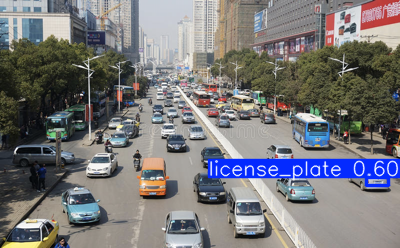


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars401.png: 480x640 1 license_plate, 22.1ms
Speed: 4.9ms preprocess, 22.1ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


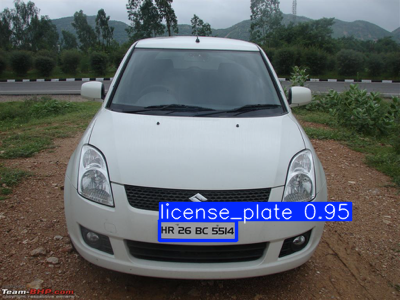


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars242.png: 640x640 1 license_plate, 26.6ms
Speed: 8.4ms preprocess, 26.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


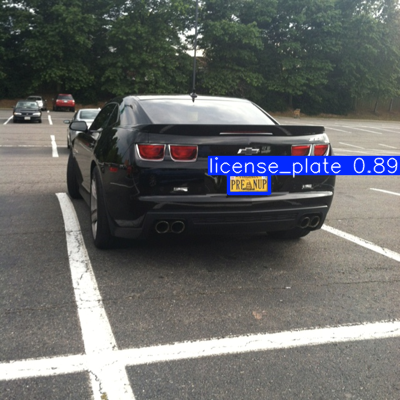


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars320.png: 640x480 1 license_plate, 24.0ms
Speed: 4.4ms preprocess, 24.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 480)


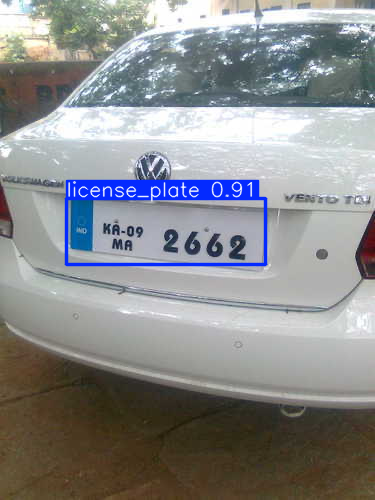


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars42.png: 384x640 1 license_plate, 14.8ms
Speed: 2.9ms preprocess, 14.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


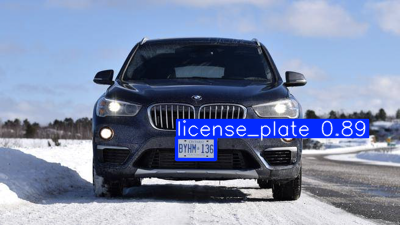


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars307.png: 448x640 1 license_plate, 12.4ms
Speed: 3.5ms preprocess, 12.4ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


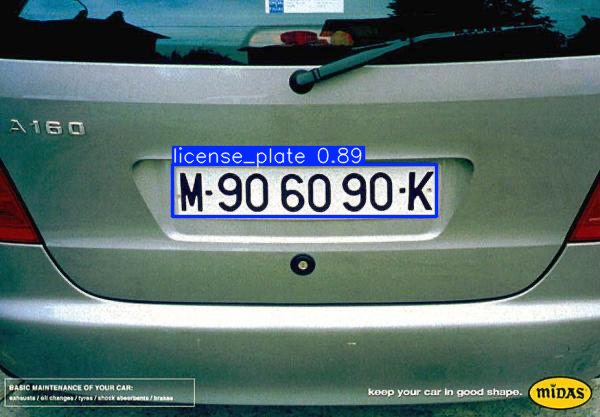


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars2.png: 640x640 1 license_plate, 16.9ms
Speed: 6.9ms preprocess, 16.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


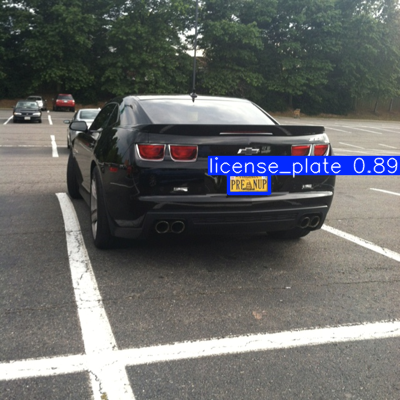


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars178.png: 480x640 1 license_plate, 13.7ms
Speed: 3.8ms preprocess, 13.7ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


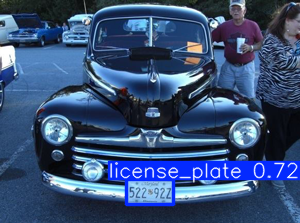


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars229.png: 384x640 (no detections), 14.6ms
Speed: 2.6ms preprocess, 14.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


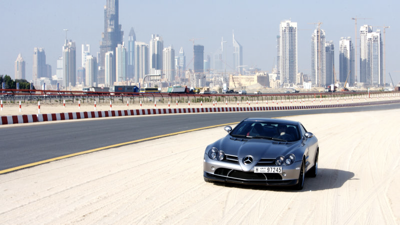


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars210.png: 448x640 1 license_plate, 13.2ms
Speed: 3.2ms preprocess, 13.2ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


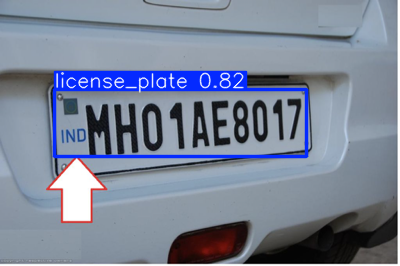


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars273.png: 384x640 1 license_plate, 15.7ms
Speed: 2.8ms preprocess, 15.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


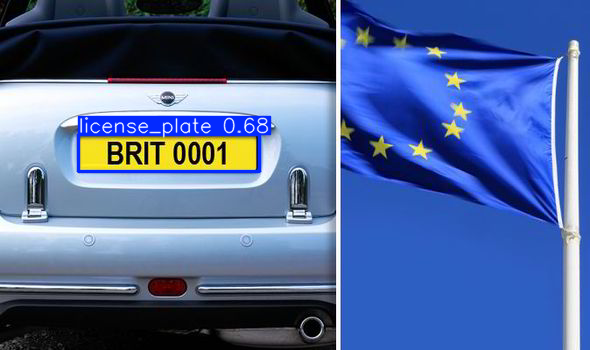


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars388.png: 480x640 (no detections), 14.5ms
Speed: 3.6ms preprocess, 14.5ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)


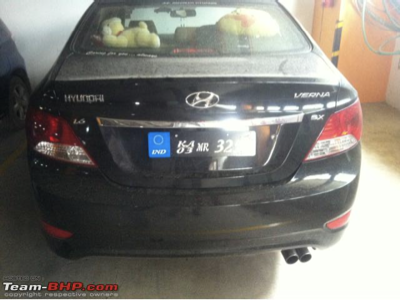


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars85.png: 448x640 1 license_plate, 14.9ms
Speed: 3.1ms preprocess, 14.9ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


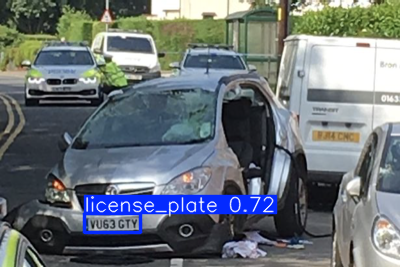


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars72.png: 544x640 1 license_plate, 19.6ms
Speed: 4.4ms preprocess, 19.6ms inference, 2.0ms postprocess per image at shape (1, 3, 544, 640)


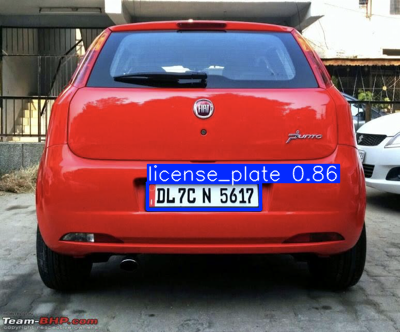


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars265.png: 352x640 1 license_plate, 20.4ms
Speed: 3.2ms preprocess, 20.4ms inference, 1.8ms postprocess per image at shape (1, 3, 352, 640)


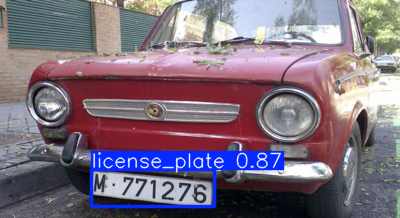


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars127.png: 448x640 1 license_plate, 18.1ms
Speed: 3.4ms preprocess, 18.1ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


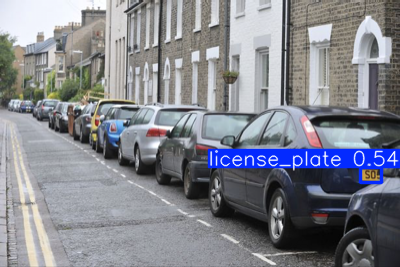


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars156.png: 320x640 1 license_plate, 20.3ms
Speed: 3.4ms preprocess, 20.3ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)


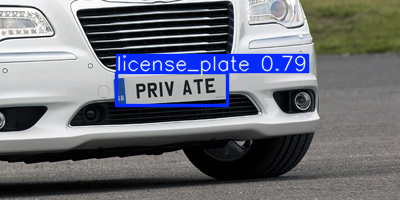


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars311.png: 448x640 1 license_plate, 22.3ms
Speed: 3.1ms preprocess, 22.3ms inference, 4.1ms postprocess per image at shape (1, 3, 448, 640)


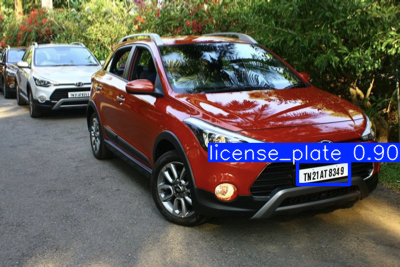


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars109.png: 448x640 1 license_plate, 21.2ms
Speed: 3.1ms preprocess, 21.2ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


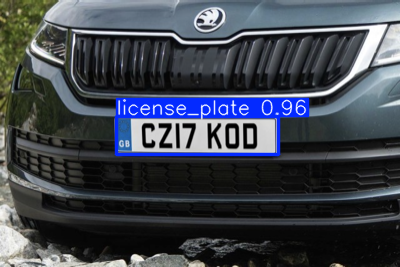


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars276.png: 448x640 1 license_plate, 23.8ms
Speed: 3.7ms preprocess, 23.8ms inference, 2.5ms postprocess per image at shape (1, 3, 448, 640)


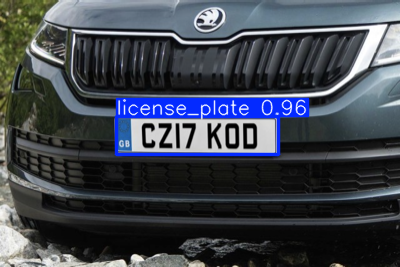


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars183.png: 384x640 1 license_plate, 21.6ms
Speed: 2.9ms preprocess, 21.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


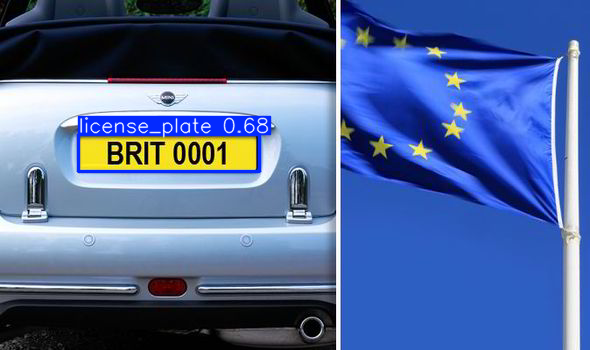


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars82.png: 256x640 1 license_plate, 24.3ms
Speed: 2.0ms preprocess, 24.3ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 640)


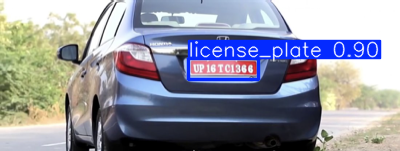


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars323.png: 384x640 1 license_plate, 24.2ms
Speed: 3.7ms preprocess, 24.2ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


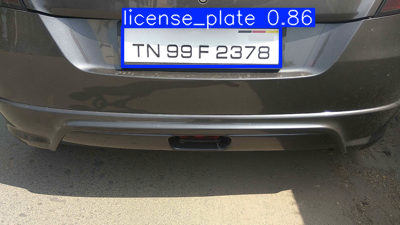


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars287.png: 544x640 1 license_plate, 21.1ms
Speed: 3.6ms preprocess, 21.1ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)


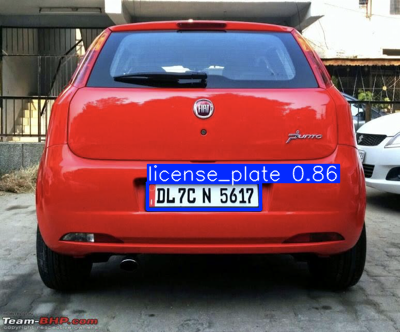


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars71.png: 384x640 2 license_plates, 14.8ms
Speed: 5.6ms preprocess, 14.8ms inference, 4.7ms postprocess per image at shape (1, 3, 384, 640)


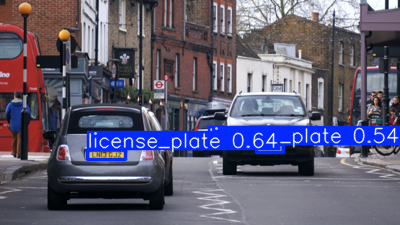


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars110.png: 448x640 (no detections), 19.9ms
Speed: 4.8ms preprocess, 19.9ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)


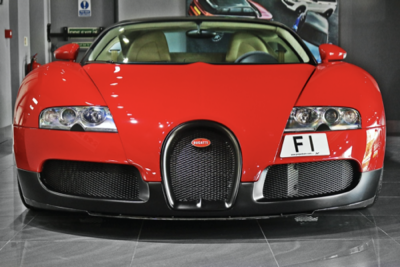


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars87.png: 480x640 2 license_plates, 23.6ms
Speed: 3.3ms preprocess, 23.6ms inference, 4.8ms postprocess per image at shape (1, 3, 480, 640)


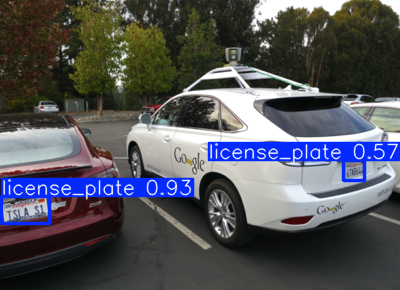


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars260.png: 384x640 (no detections), 20.5ms
Speed: 7.7ms preprocess, 20.5ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


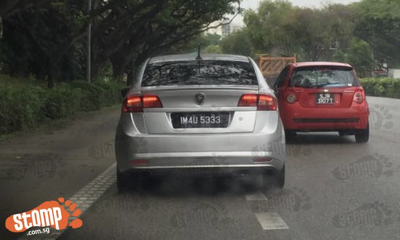


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars32.png: 480x640 1 license_plate, 16.2ms
Speed: 3.3ms preprocess, 16.2ms inference, 2.5ms postprocess per image at shape (1, 3, 480, 640)


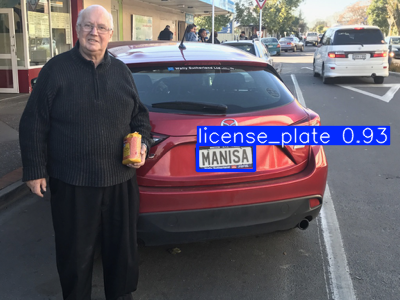


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars166.png: 640x480 1 license_plate, 22.5ms
Speed: 4.1ms preprocess, 22.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)


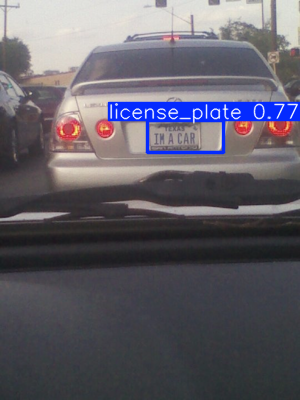


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars164.png: 448x640 1 license_plate, 19.0ms
Speed: 3.3ms preprocess, 19.0ms inference, 2.1ms postprocess per image at shape (1, 3, 448, 640)


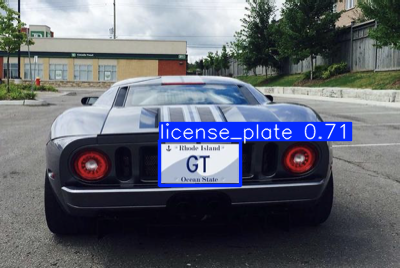


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars419.png: 576x640 1 license_plate, 17.4ms
Speed: 4.1ms preprocess, 17.4ms inference, 1.7ms postprocess per image at shape (1, 3, 576, 640)


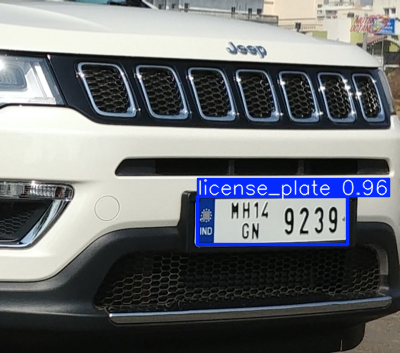


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars284.png: 640x480 1 license_plate, 16.4ms
Speed: 5.7ms preprocess, 16.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)


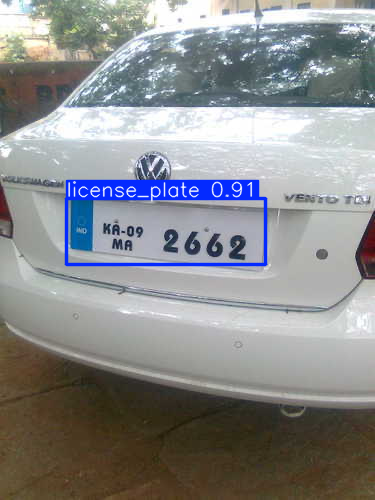


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars21.png: 512x640 (no detections), 15.2ms
Speed: 3.6ms preprocess, 15.2ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)


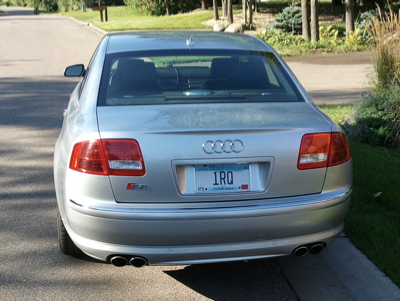


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars370.png: 448x640 1 license_plate, 19.4ms
Speed: 3.5ms preprocess, 19.4ms inference, 2.1ms postprocess per image at shape (1, 3, 448, 640)


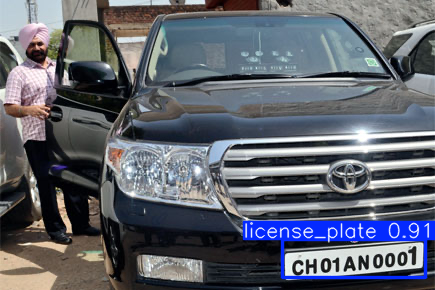


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars257.png: 480x640 1 license_plate, 21.3ms
Speed: 6.1ms preprocess, 21.3ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


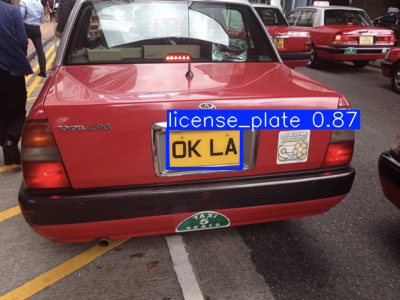


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars63.png: 448x640 (no detections), 22.9ms
Speed: 4.5ms preprocess, 22.9ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)


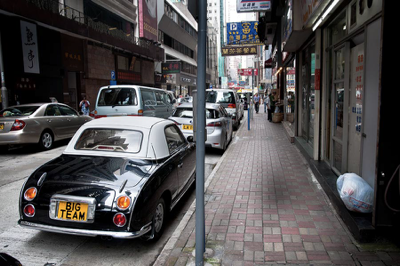


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars120.png: 448x640 1 license_plate, 14.1ms
Speed: 3.0ms preprocess, 14.1ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)


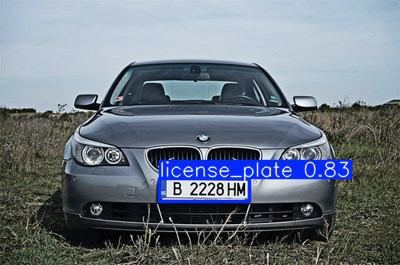


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars340.png: 320x640 1 license_plate, 16.7ms
Speed: 2.5ms preprocess, 16.7ms inference, 3.6ms postprocess per image at shape (1, 3, 320, 640)


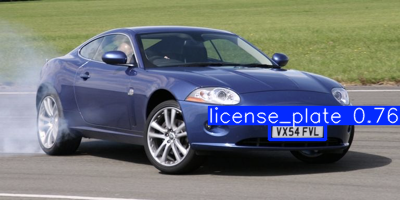


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars66.png: 480x640 1 license_plate, 19.6ms
Speed: 3.1ms preprocess, 19.6ms inference, 4.3ms postprocess per image at shape (1, 3, 480, 640)


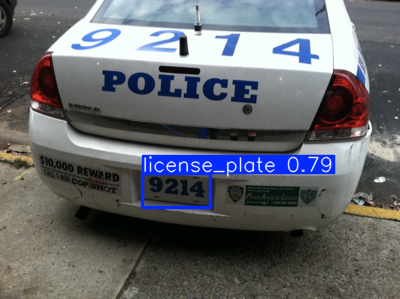


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars355.png: 448x640 1 license_plate, 19.7ms
Speed: 3.2ms preprocess, 19.7ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


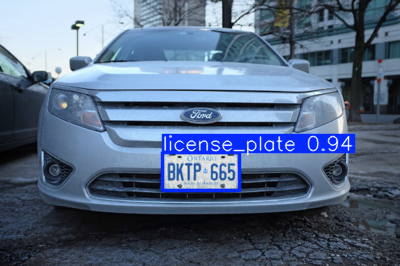


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars328.png: 384x640 1 license_plate, 14.0ms
Speed: 2.5ms preprocess, 14.0ms inference, 5.6ms postprocess per image at shape (1, 3, 384, 640)


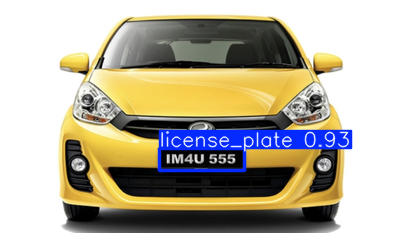


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars319.png: 576x640 1 license_plate, 20.3ms
Speed: 5.8ms preprocess, 20.3ms inference, 1.7ms postprocess per image at shape (1, 3, 576, 640)


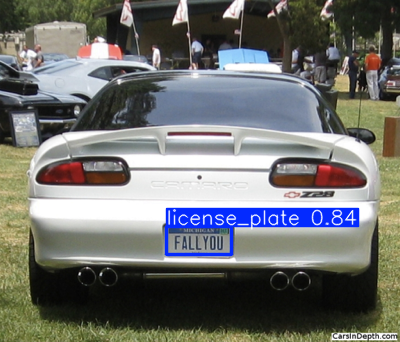


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars230.png: 384x640 1 license_plate, 17.4ms
Speed: 3.0ms preprocess, 17.4ms inference, 3.9ms postprocess per image at shape (1, 3, 384, 640)


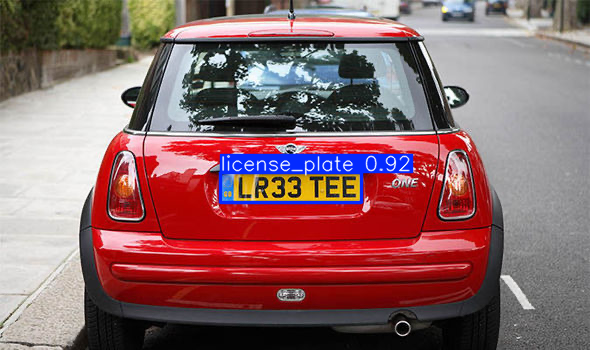


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars202.png: 480x640 1 license_plate, 23.9ms
Speed: 3.0ms preprocess, 23.9ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


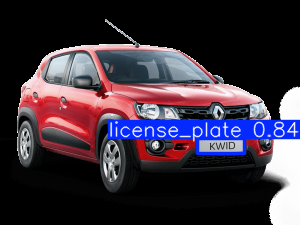


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars194.png: 448x640 1 license_plate, 14.5ms
Speed: 3.2ms preprocess, 14.5ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


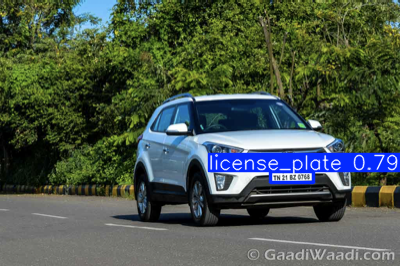


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars253.png: 352x640 1 license_plate, 18.0ms
Speed: 2.6ms preprocess, 18.0ms inference, 2.0ms postprocess per image at shape (1, 3, 352, 640)


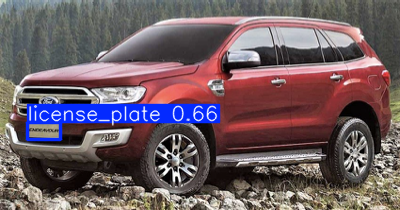


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars266.png: 384x640 1 license_plate, 19.9ms
Speed: 2.7ms preprocess, 19.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


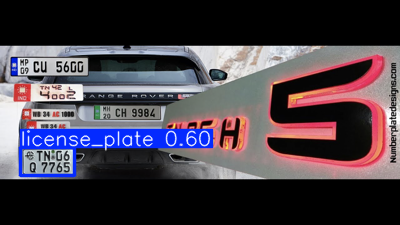


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars218.png: 416x640 1 license_plate, 14.1ms
Speed: 2.7ms preprocess, 14.1ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


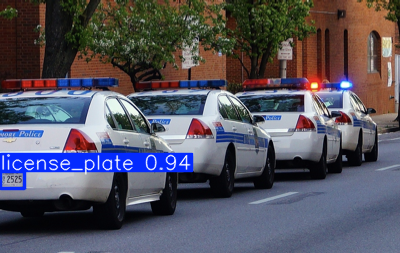


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars416.png: 480x640 1 license_plate, 14.2ms
Speed: 3.5ms preprocess, 14.2ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


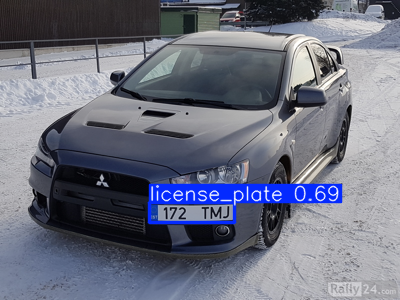


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars198.png: 512x640 1 license_plate, 18.8ms
Speed: 6.5ms preprocess, 18.8ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 640)


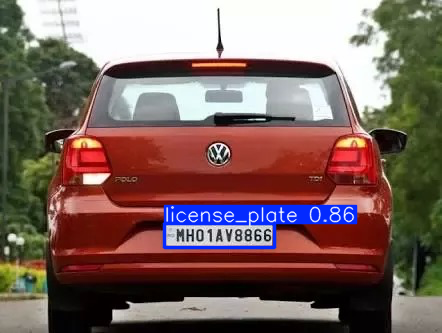


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars157.png: 448x640 1 license_plate, 14.1ms
Speed: 3.0ms preprocess, 14.1ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


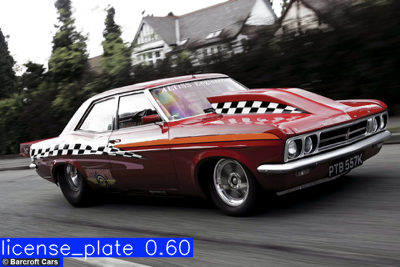


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars28.png: 480x640 1 license_plate, 19.4ms
Speed: 3.6ms preprocess, 19.4ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


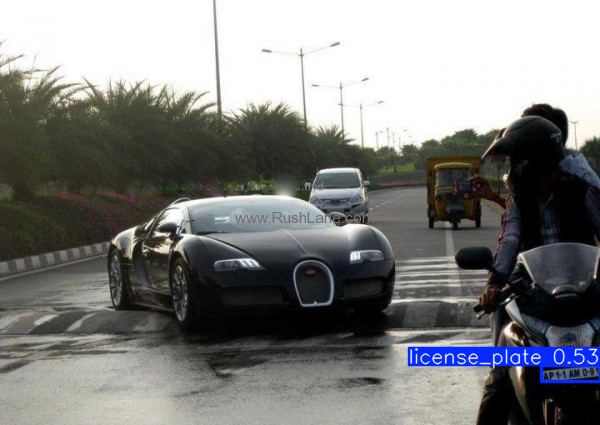


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars161.png: 512x640 1 license_plate, 18.5ms
Speed: 4.2ms preprocess, 18.5ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 640)


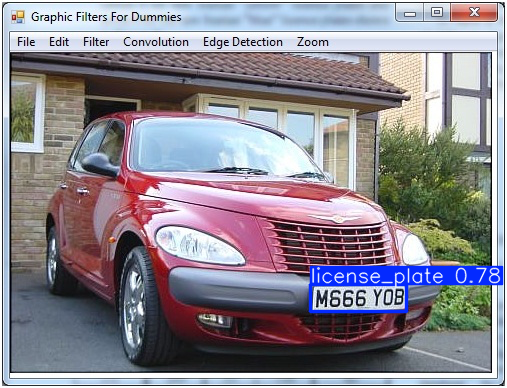


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars34.png: 544x640 1 license_plate, 16.7ms
Speed: 3.8ms preprocess, 16.7ms inference, 2.0ms postprocess per image at shape (1, 3, 544, 640)


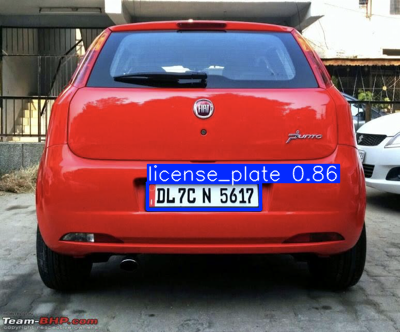


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars84.png: 480x640 1 license_plate, 18.0ms
Speed: 3.8ms preprocess, 18.0ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


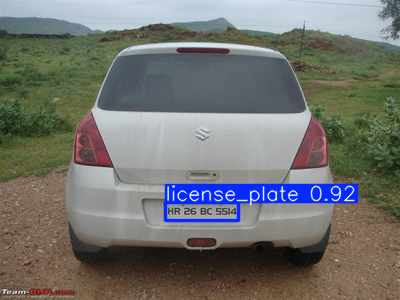


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars208.png: 448x640 1 license_plate, 15.4ms
Speed: 3.6ms preprocess, 15.4ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)


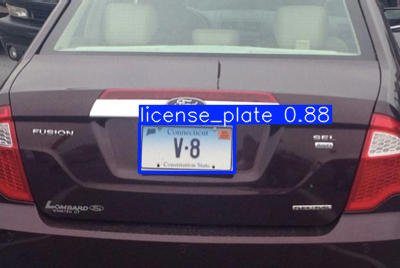


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars360.png: 384x640 1 license_plate, 18.8ms
Speed: 2.7ms preprocess, 18.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


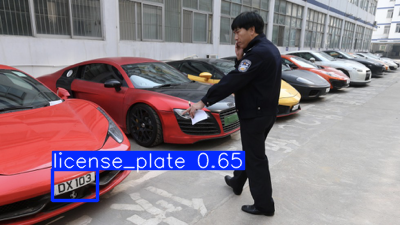


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars159.png: 544x640 1 license_plate, 19.0ms
Speed: 3.7ms preprocess, 19.0ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 640)


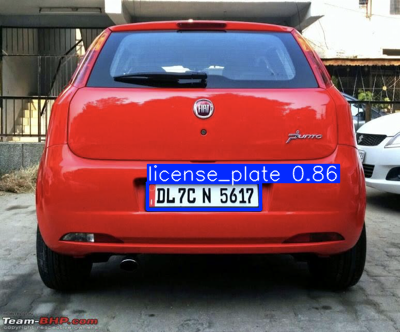


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars246.png: 448x640 1 license_plate, 16.8ms
Speed: 3.2ms preprocess, 16.8ms inference, 5.0ms postprocess per image at shape (1, 3, 448, 640)


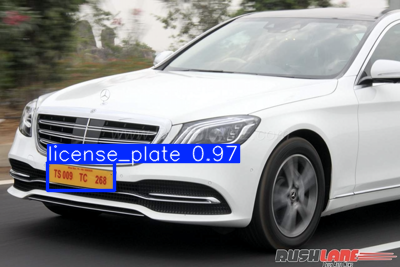


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars62.png: 480x640 1 license_plate, 20.6ms
Speed: 3.4ms preprocess, 20.6ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


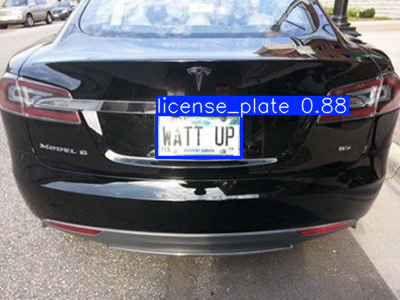


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars343.png: 480x640 1 license_plate, 22.0ms
Speed: 3.3ms preprocess, 22.0ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


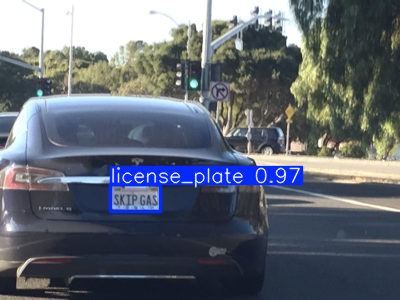


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars281.png: 416x640 1 license_plate, 22.1ms
Speed: 3.2ms preprocess, 22.1ms inference, 6.4ms postprocess per image at shape (1, 3, 416, 640)


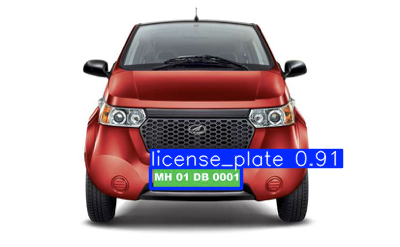


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars393.png: 352x640 1 license_plate, 15.9ms
Speed: 5.3ms preprocess, 15.9ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)


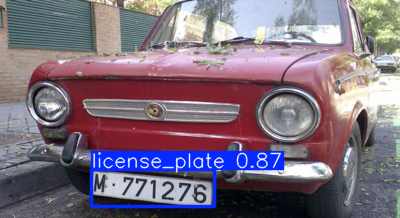


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars415.png: 480x640 1 license_plate, 18.3ms
Speed: 3.7ms preprocess, 18.3ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


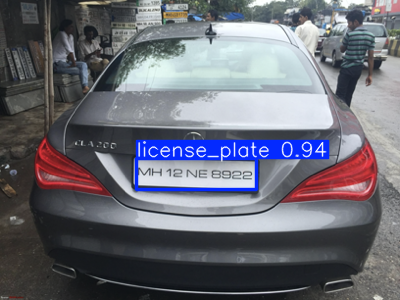


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars77.png: 448x640 1 license_plate, 15.4ms
Speed: 6.2ms preprocess, 15.4ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


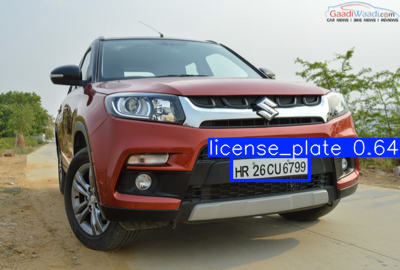


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars333.png: 448x640 2 license_plates, 13.1ms
Speed: 3.2ms preprocess, 13.1ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


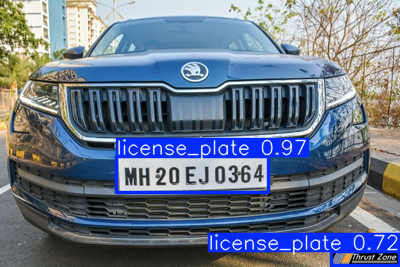


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars86.png: 384x640 1 license_plate, 17.5ms
Speed: 2.9ms preprocess, 17.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


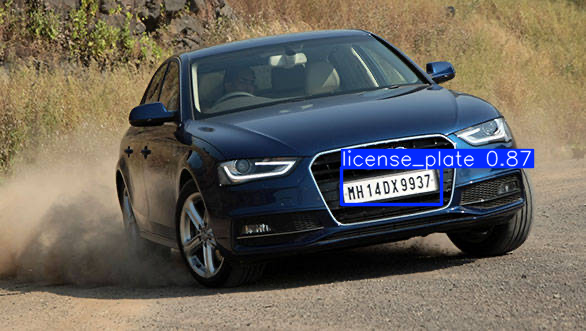


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars12.png: 256x640 1 license_plate, 19.6ms
Speed: 6.9ms preprocess, 19.6ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 640)


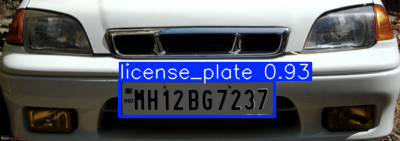


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars179.png: 448x640 2 license_plates, 19.0ms
Speed: 7.2ms preprocess, 19.0ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


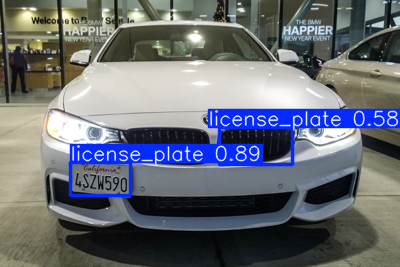


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars25.png: 384x640 1 license_plate, 16.0ms
Speed: 3.7ms preprocess, 16.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


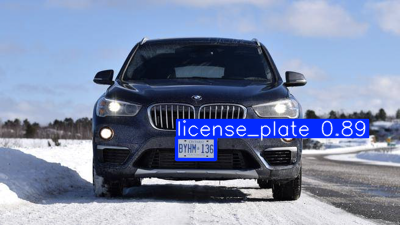


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars422.png: 384x640 (no detections), 15.6ms
Speed: 8.0ms preprocess, 15.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


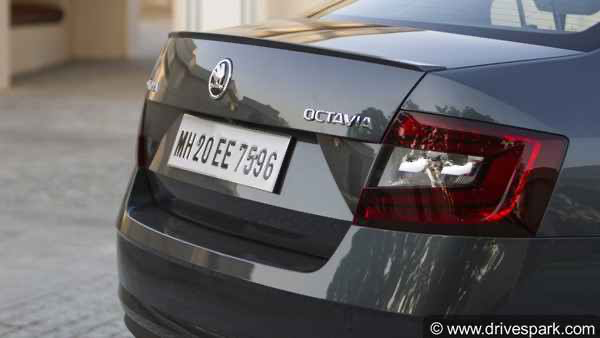


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars33.png: 384x640 1 license_plate, 16.3ms
Speed: 2.6ms preprocess, 16.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


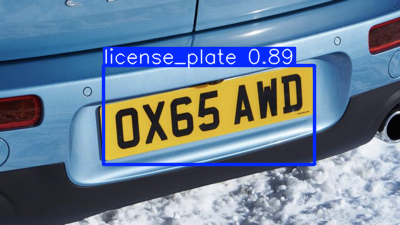


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars396.png: 640x480 1 license_plate, 24.6ms
Speed: 5.7ms preprocess, 24.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)


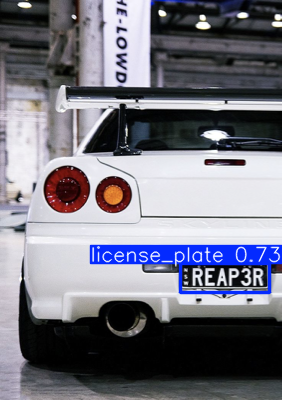


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars44.png: 480x640 1 license_plate, 20.5ms
Speed: 3.3ms preprocess, 20.5ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


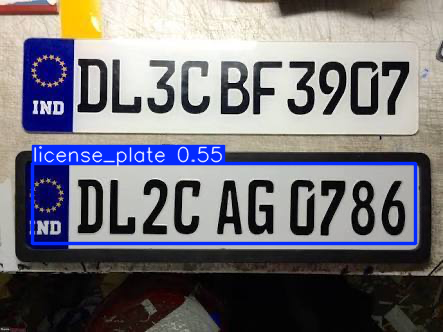


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars165.png: 384x640 1 license_plate, 17.5ms
Speed: 2.8ms preprocess, 17.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


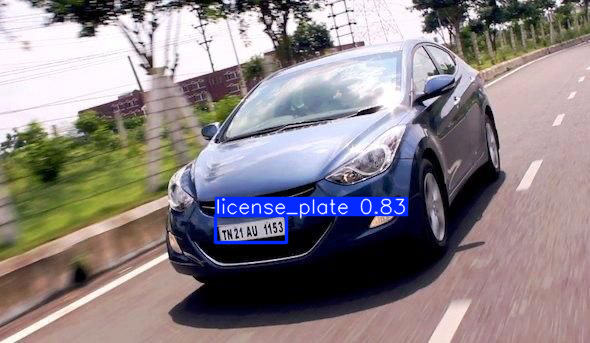


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars394.png: 480x640 (no detections), 15.6ms
Speed: 3.6ms preprocess, 15.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


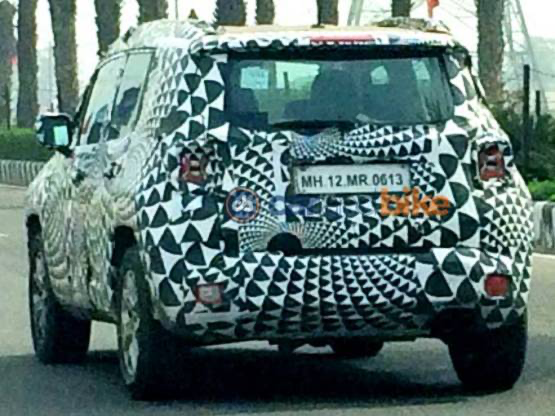


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars350.png: 448x640 1 license_plate, 17.7ms
Speed: 3.2ms preprocess, 17.7ms inference, 4.9ms postprocess per image at shape (1, 3, 448, 640)


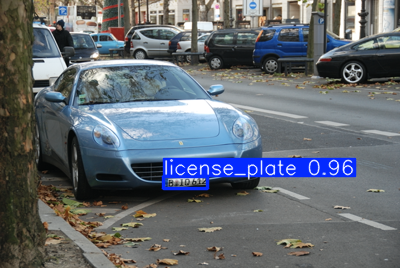


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars255.png: 448x640 2 license_plates, 16.2ms
Speed: 3.0ms preprocess, 16.2ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)


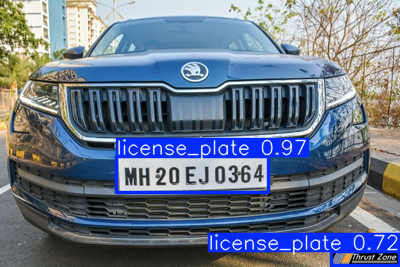


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars423.png: 416x640 1 license_plate, 18.4ms
Speed: 6.5ms preprocess, 18.4ms inference, 5.2ms postprocess per image at shape (1, 3, 416, 640)


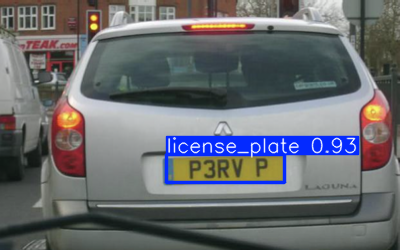


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars8.png: 320x640 1 license_plate, 14.5ms
Speed: 2.4ms preprocess, 14.5ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)


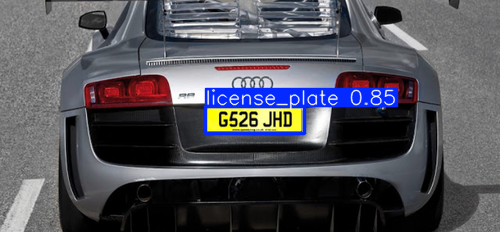


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars162.png: 384x640 (no detections), 18.0ms
Speed: 5.7ms preprocess, 18.0ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


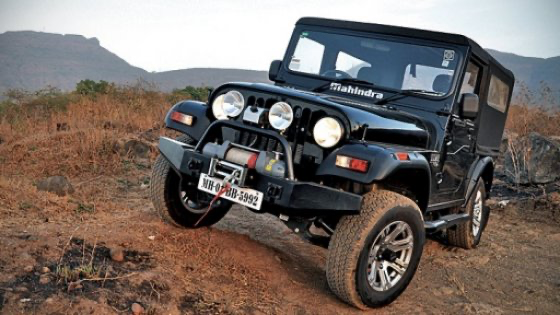


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars135.png: 384x640 (no detections), 15.1ms
Speed: 2.8ms preprocess, 15.1ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


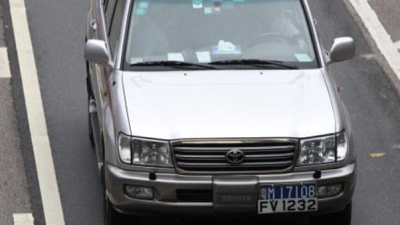


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars334.png: 352x640 1 license_plate, 24.4ms
Speed: 7.9ms preprocess, 24.4ms inference, 2.1ms postprocess per image at shape (1, 3, 352, 640)


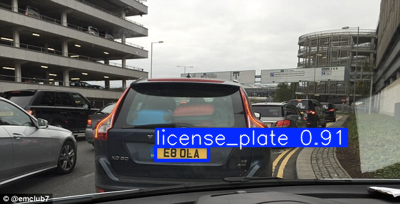


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars254.png: 608x640 1 license_plate, 15.3ms
Speed: 3.9ms preprocess, 15.3ms inference, 1.8ms postprocess per image at shape (1, 3, 608, 640)


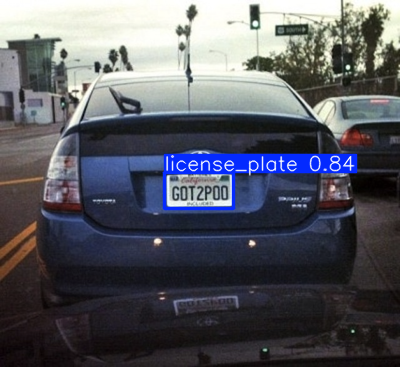


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars174.png: 384x640 (no detections), 15.0ms
Speed: 2.7ms preprocess, 15.0ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


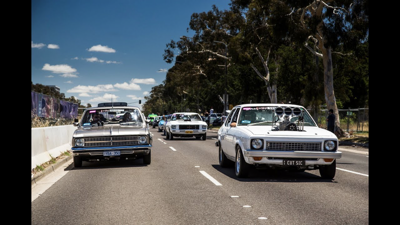


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars119.png: 416x640 1 license_plate, 14.3ms
Speed: 3.0ms preprocess, 14.3ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


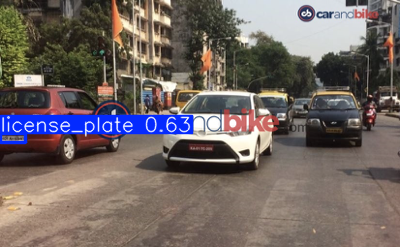

In [ ]:
import glob
from PIL import Image

image_folder = test_path + '/images'

image_files = glob.glob(os.path.join(image_folder, '*.png'))  # Tüm .png dosyalarını al

for image_path in image_files:
    image = cv2.imread(image_path)

    results = trained_model.predict(image_path, conf=0.5)

    plot = results[0].plot()
    plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
    display(Image.fromarray(plot))


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars75.png: 416x640 1 license_plate, 17.3ms
Speed: 2.8ms preprocess, 17.3ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)
Plakada yazanlar: 


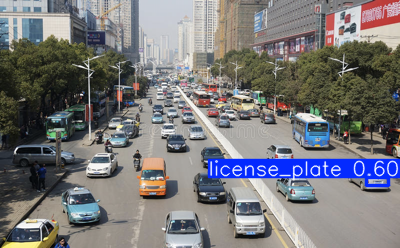


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars401.png: 480x640 1 license_plate, 13.0ms
Speed: 3.1ms preprocess, 13.0ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)
Plakada yazanlar: HR 26 BC 5514


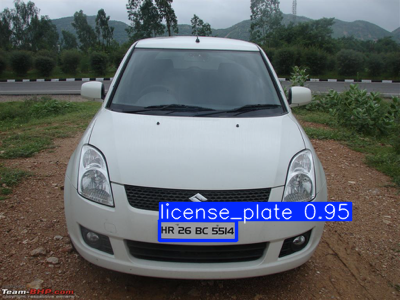


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars242.png: 640x640 1 license_plate, 15.0ms
Speed: 3.9ms preprocess, 15.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Plakada yazanlar: PREALLR


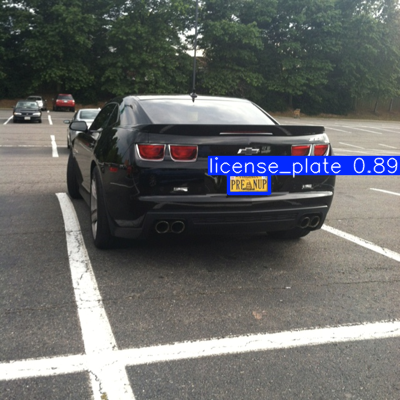


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars320.png: 640x480 1 license_plate, 14.5ms
Speed: 3.2ms preprocess, 14.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)
Plakada yazanlar: Ka-09 Ma 2662


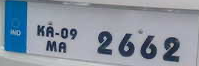

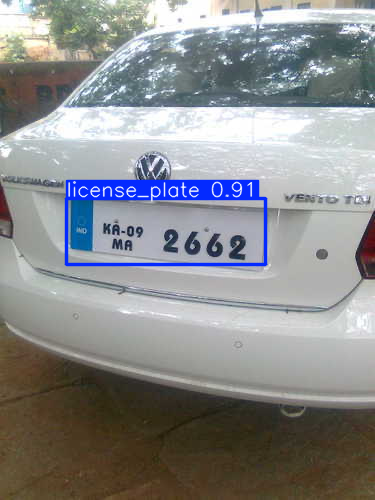


image 1/1 /root/.cache/kagglehub/datasets/sujaymann/car-number-plate-dataset-yolo-format/versions/3/License-Plate-Data/test/images/Cars42.png: 384x640 1 license_plate, 13.8ms
Speed: 2.6ms preprocess, 13.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Plakada yazanlar: ByHA' 136


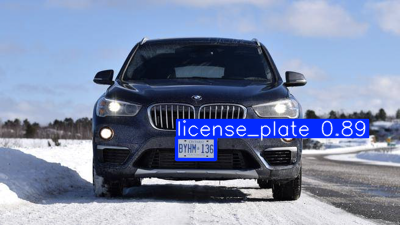

In [ ]:
import easyocr
import glob
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image

reader = easyocr.Reader(['en'])

for image_path in image_files[0:number_of_images]:
    image = cv2.imread(image_path)

    results = trained_model.predict(image_path)

    for result in results[0].boxes:
        x_min, y_min, x_max, y_max = map(int, result.xyxy[0])

        cropped_plate = image[y_min:y_max, x_min:x_max]

        plaka_yazi = reader.readtext(cropped_plate)

        plaka_metni = " ".join([text[1] for text in plaka_yazi])
        print(f"Plakada yazanlar:", plaka_metni)

        cv2_imshow(cropped_plate)
        cv2.waitKey(0)
        cv2.destroyAllWindows()

    plot = results[0].plot()
    plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
    display(Image.fromarray(plot))
